In [ ]:
# usefull function
def draw_dbscan(origin, labell):
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1)
  plt.title('Original Image')
  plt.imshow(origin, cmap='gray')
  plt.subplot(1, 2, 2)
  plt.title('DBSCAN Clustering Result')
  plt.imshow(labell, cmap='viridis')
  plt.show()

In [ ]:
def draw_result(origin, labell, name_method='minimum', true_plot=None):
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 3, 1)
  plt.title(f'Input Image {name_method}')
  plt.imshow(origin, cmap='gray')

  if not true_plot is None:
    plt.subplot(1, 3, 2)
    plt.title(f'True marked data: {name_method}')
    plt.imshow(true_plot, cmap='viridis')

  plt.subplot(1, 3, 3)
  plt.title(f'DBSCAN Clustering  on {name_method}')
  plt.imshow(labell, cmap='viridis')
  plt.show()

# Search Papers

## Dataset
1. https://www.digitalrocksportal.org/projects/
2.
## Resource
1. https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_multiotsu.html

In [ ]:
import os
import zipfile

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

from skimage import data
from skimage.filters import threshold_multiotsu
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error as mse
from skimage import img_as_ubyte
from skimage import io, color

from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans

from scipy.fft import fft, fftfreq
from scipy.ndimage import *
from scipy.stats import pearsonr

import pywt

from PIL import Image

In [ ]:
im = Image.open('rec_00400.tif')

imarray = np.array(im)

im.show()

In [ ]:
imarray.shape

(2615, 2615)

# Data Review

<Axes: >

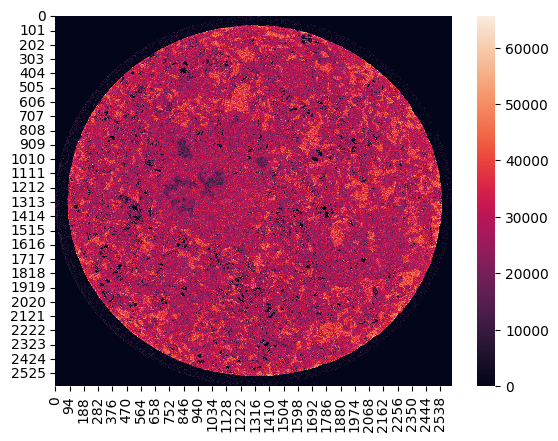

In [ ]:
sns.heatmap(imarray)

<Axes: >

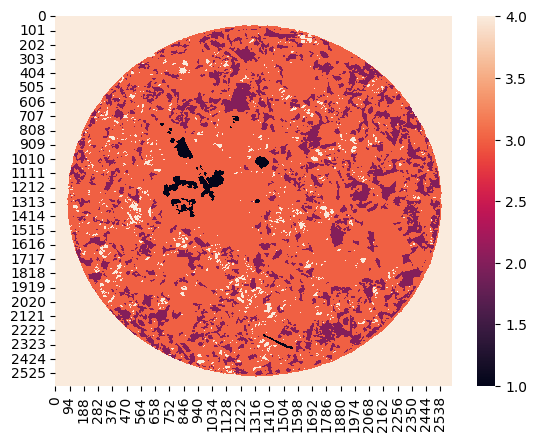

In [ ]:
res = Image.open('Label_400_final.tif')

res = np.array(res)

sns.heatmap(res)

In [ ]:
np.unique(res)

array([1, 2, 3, 4], dtype=uint8)

# Removing rim

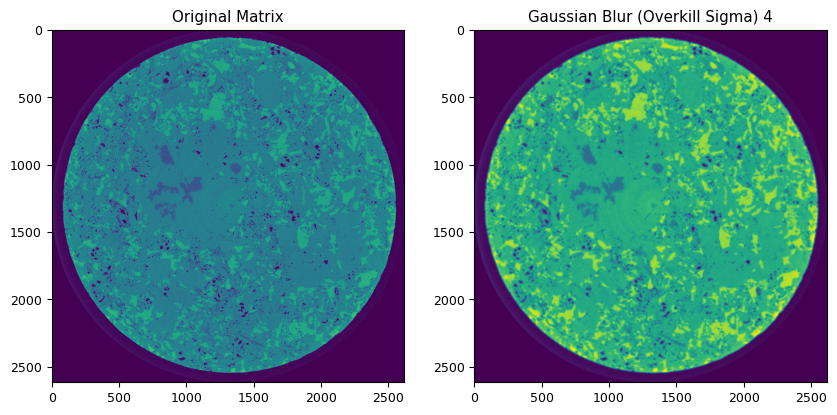

In [ ]:
# Simple blur gauss
matrix = imarray.copy()
sigma = 4

blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

plt.subplot(1, 2, 2)
plt.imshow(blurred_gaussian, cmap='viridis')
plt.title(f'Gaussian Blur (Overkill Sigma) {sigma}')

plt.show()

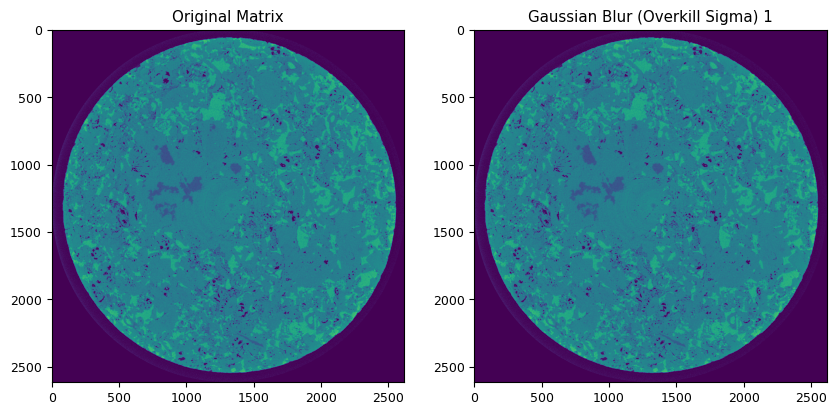

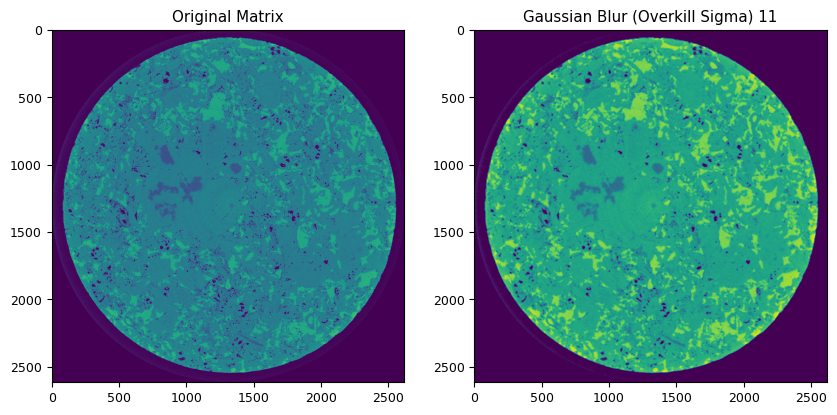

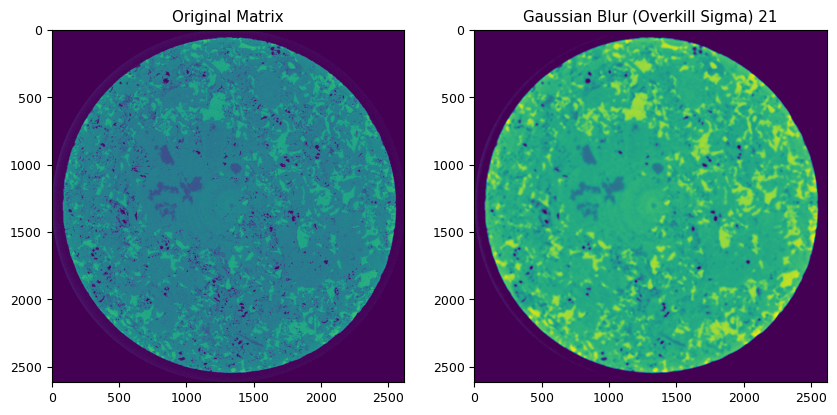

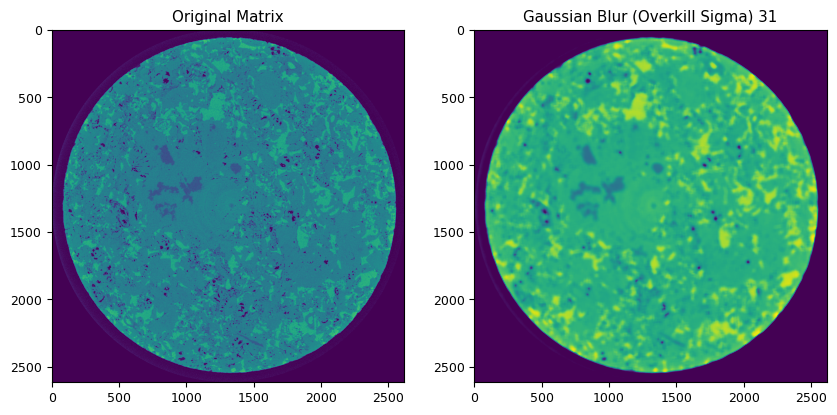

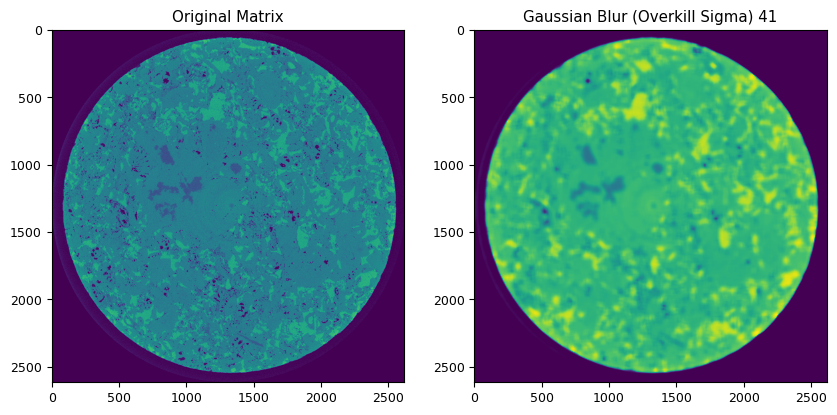

In [ ]:
# Simple blur median
matrix = imarray.copy()
sigma = 50

for sigma_overkill in range(1, sigma, 10):
  blurred_median = median_filter(matrix, size=sigma_overkill)

  plt.figure(figsize=(10, 5))

  plt.subplot(1, 2, 1)
  plt.imshow(matrix, cmap='viridis')
  plt.title('Original Matrix')

  plt.subplot(1, 2, 2)
  plt.imshow(blurred_median, cmap='viridis')
  plt.title(f'Median Blur (Overkill Sigma) {sigma_overkill}')

  plt.show()

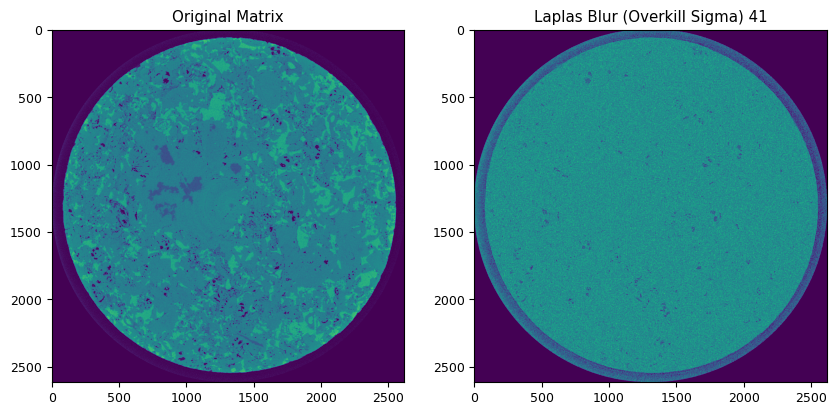

In [ ]:
# Simple blur lapls
matrix = imarray.copy()
sigma = 50

lapls = laplace(matrix)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

plt.subplot(1, 2, 2)
plt.imshow(lapls, cmap='viridis')
plt.title(f'Laplas Blur (Overkill Sigma) {sigma_overkill}')

plt.show()

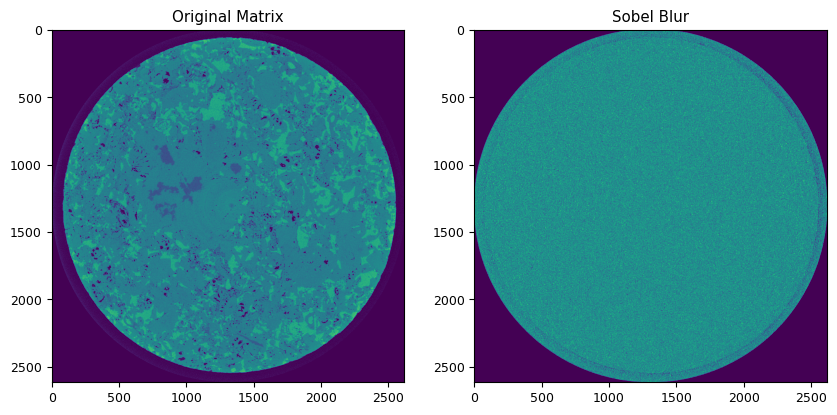

In [ ]:
# Simple blur sobel
matrix = imarray.copy()
sigma = 50

sobell = sobel(matrix)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

plt.subplot(1, 2, 2)
plt.imshow(sobell, cmap='viridis')
plt.title(f'Sobel Blur')

plt.show()

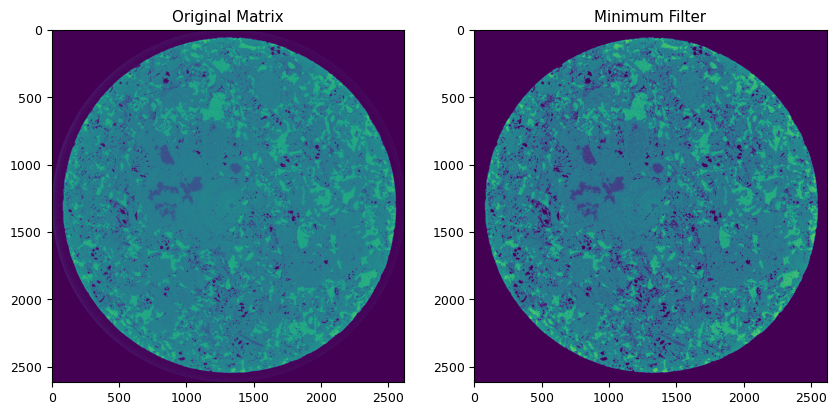

In [ ]:
matrix = imarray.copy()

size = 3
min_filtered = minimum_filter(matrix, size=size)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

plt.subplot(1, 2, 2)
plt.imshow(min_filtered, cmap='viridis')
plt.title('Minimum Filter')

plt.show()

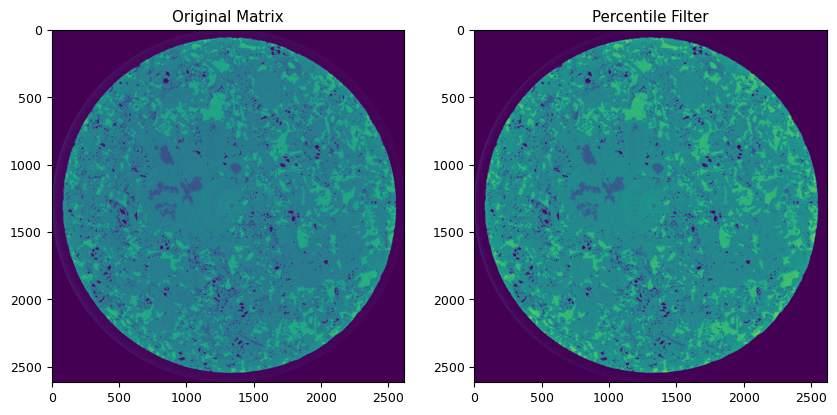

In [ ]:
matrix = imarray.copy()

percentile = 50
size = 3
percentile_filtered = percentile_filter(matrix, percentile, size=size)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

plt.subplot(1, 2, 2)
plt.imshow(percentile_filtered, cmap='viridis')
plt.title('Percentile Filter')

plt.show()

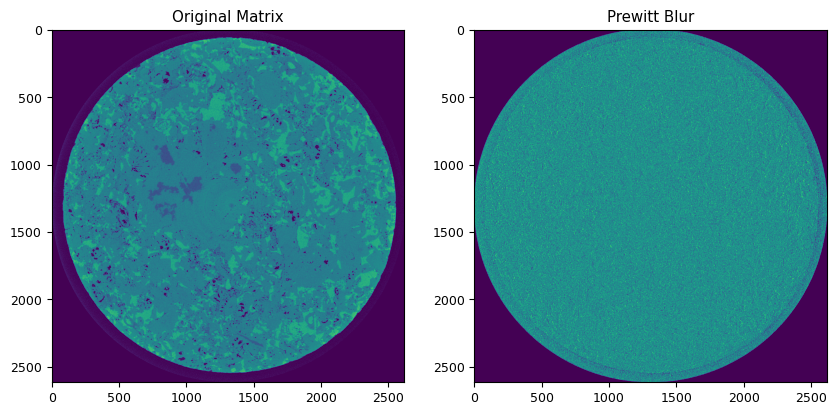

In [ ]:
matrix = imarray.copy()

prewitt_result = prewitt(matrix)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

plt.subplot(1, 2, 2)
plt.imshow(prewitt_result, cmap='viridis')
plt.title('Prewitt Blur')

plt.show()

### All methods

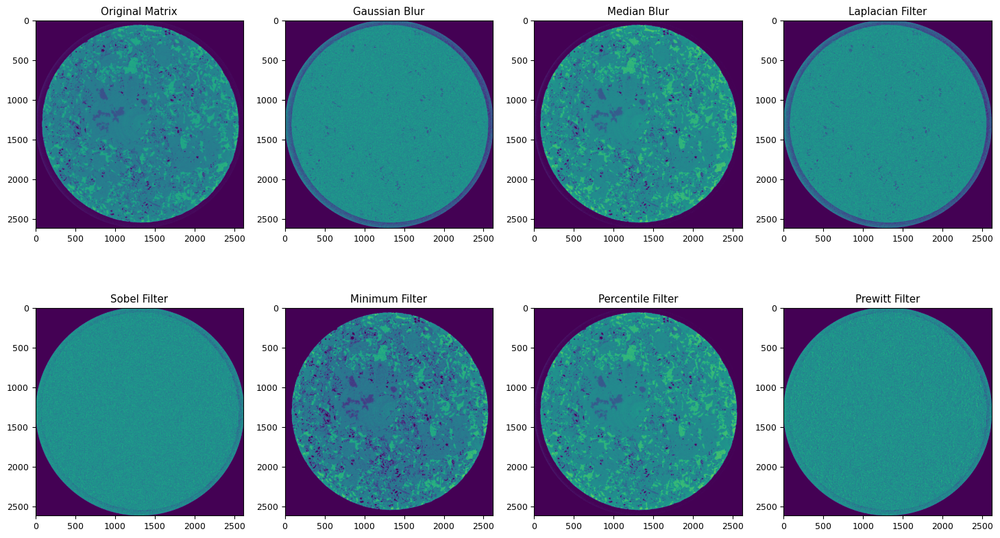

In [ ]:
plt.figure(figsize=(18, 10))

# Original Matrix
plt.subplot(2, 4, 1)
plt.imshow(matrix, cmap='viridis')
plt.title('Original Matrix')

# Blurred Gaussian
plt.subplot(2, 4, 2)
plt.imshow(blurred_gaussian, cmap='viridis')
plt.title('Gaussian Blur')

# Blurred Median
plt.subplot(2, 4, 3)
plt.imshow(blurred_median, cmap='viridis')
plt.title('Median Blur')

# Laplacian Filter
plt.subplot(2, 4, 4)
plt.imshow(lapls, cmap='viridis')
plt.title('Laplacian Filter')

# Sobel Filter
plt.subplot(2, 4, 5)
plt.imshow(sobell, cmap='viridis')
plt.title('Sobel Filter')

# Minimum Filter
plt.subplot(2, 4, 6)
plt.imshow(min_filtered, cmap='viridis')
plt.title('Minimum Filter')

# Percentile Filter
plt.subplot(2, 4, 7)
plt.imshow(percentile_filtered, cmap='viridis')
plt.title('Percentile Filter')

# Prewitt Filter
plt.subplot(2, 4, 8)
plt.imshow(prewitt_result, cmap='viridis')
plt.title('Prewitt Filter')

plt.show()

#### Save results

In [ ]:
filters = [
    ('Gaussian Blur', gaussian_filter, {'sigma': 7.0}),
    ('Median Blur', median_filter, {'size': 3}),
    ('Laplacian Filter', laplace, {}),
    ('Sobel Filter', sobel, {}),
    ('Minimum Filter', minimum_filter, {'size': 3}),
    ('Percentile Filter', percentile_filter, {'percentile': 50, 'size': 3}),
    ('Prewitt Filter', prewitt, {})
]

for filter_name, filter_function, filter_params in filters:
    result = filter_function(matrix, **filter_params)

    result_uint8 = result.astype(np.uint8)

    image = Image.fromarray(result_uint8)

    filename = f'source/{filter_name.replace(" ", "_").lower()}_result.png'
    image.save(filename)

print("Images saved successfully.")

Images saved successfully.


In [ ]:
def zip_folder(folder_path, output_path):
    with zipfile.ZipFile(output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                arcname = os.path.relpath(file_path, folder_path)
                zipf.write(file_path, arcname=arcname)
zip_folder('source', 'analysis_methods_blur.zip')

# Analysis main segments

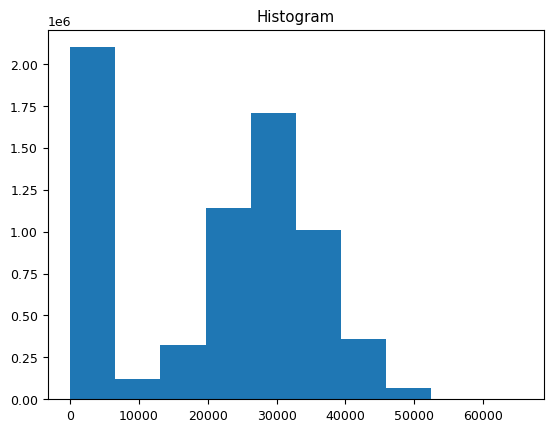

In [ ]:
image = im

plt.hist(np.ravel(image))
plt.title('Histogram')

plt.show()

In [ ]:
image2 = np.ravel(image)
without_zero = image2[image2 > 1]

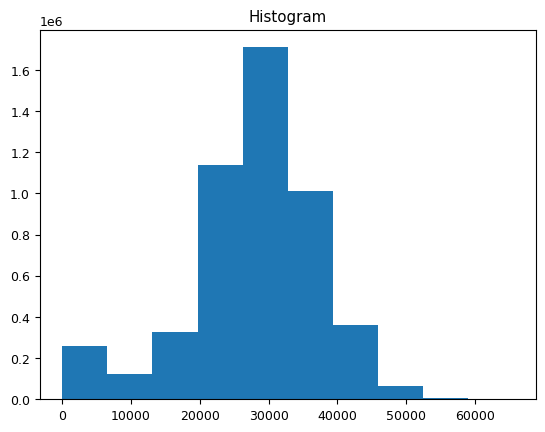

In [ ]:
plt.hist(without_zero, histtype='stepfilled')
plt.title('Histogram')
plt.show()

# Clustering

## DB-Scan

In [ ]:
def test_db_scan(kern_part, name='min_filtered'):
  flattened_data = kern_part.flatten().reshape(-1, 1)

  dbscan = DBSCAN(eps=0.5, min_samples=8)
  labels = dbscan.fit_predict(flattened_data)

  labels_2d = labels.reshape(kern_part.shape)

  draw_result(kern_part, labels_2d, name)

### Min filtered

(303, 303)


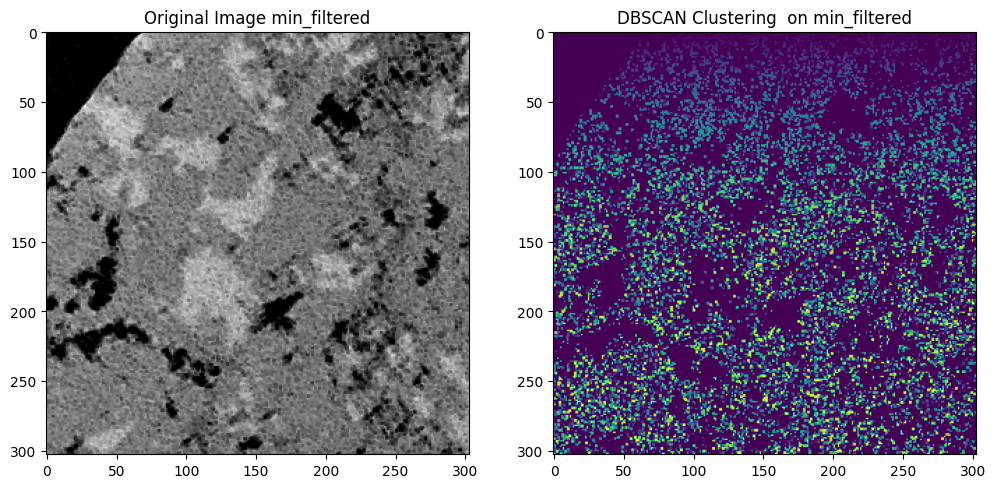

In [ ]:
matrix = imarray.copy()

size = 2
min_filtered = minimum_filter(matrix, size=size)

kern_part = min_filtered[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'min_filtered')
# sns.heatmap(kern_part)

### Median

(303, 303)


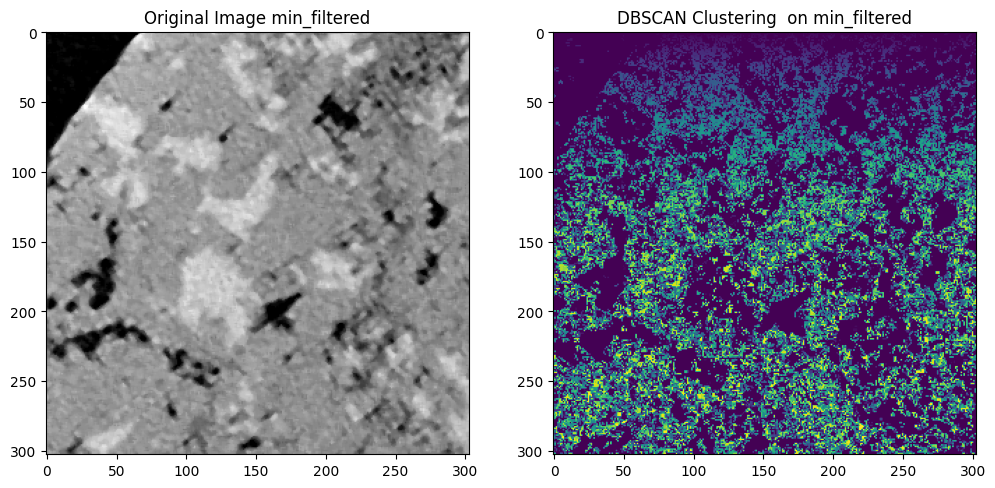

In [ ]:
matrix = imarray.copy()
sigma = 4

blurred_median = median_filter(matrix, size=sigma)

kern_part = blurred_median[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'min_filtered')

### Gaussian

(303, 303)


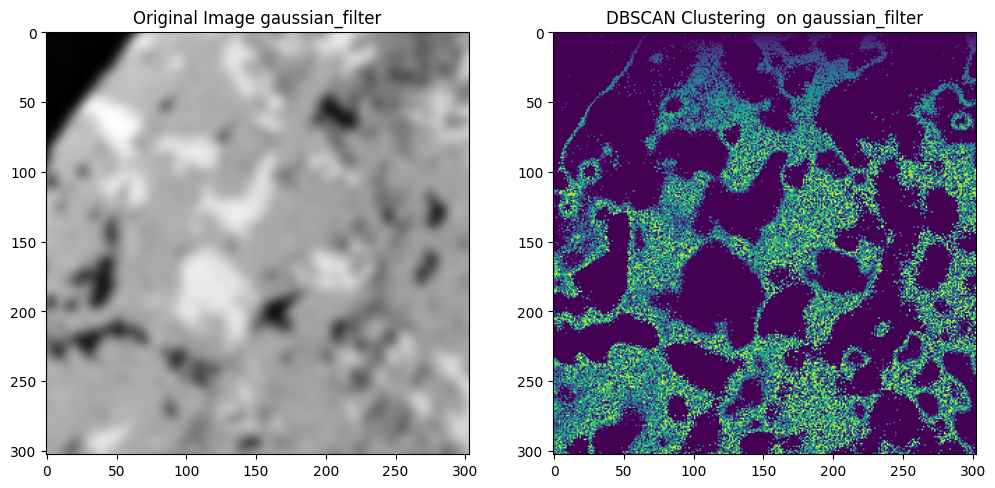

In [ ]:
matrix = imarray.copy()
sigma = 4
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


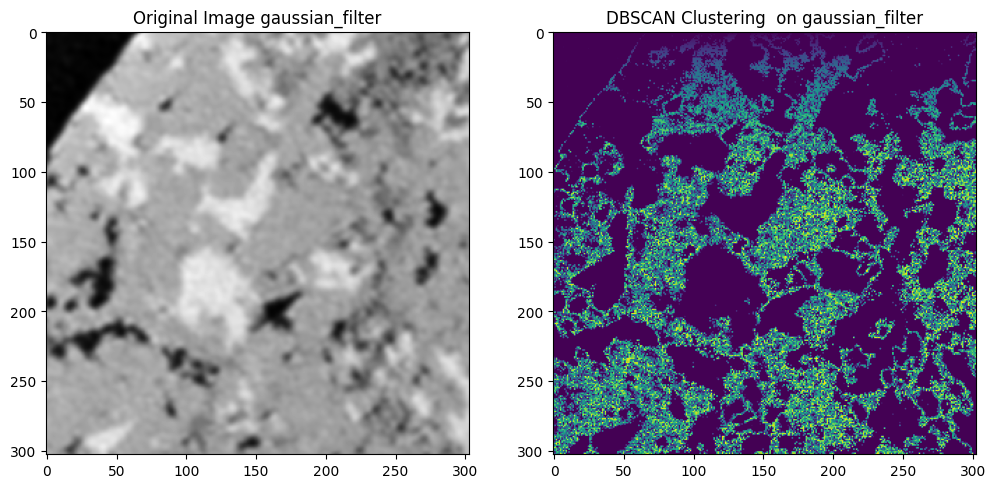

In [ ]:
matrix = imarray.copy()
sigma = 2
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


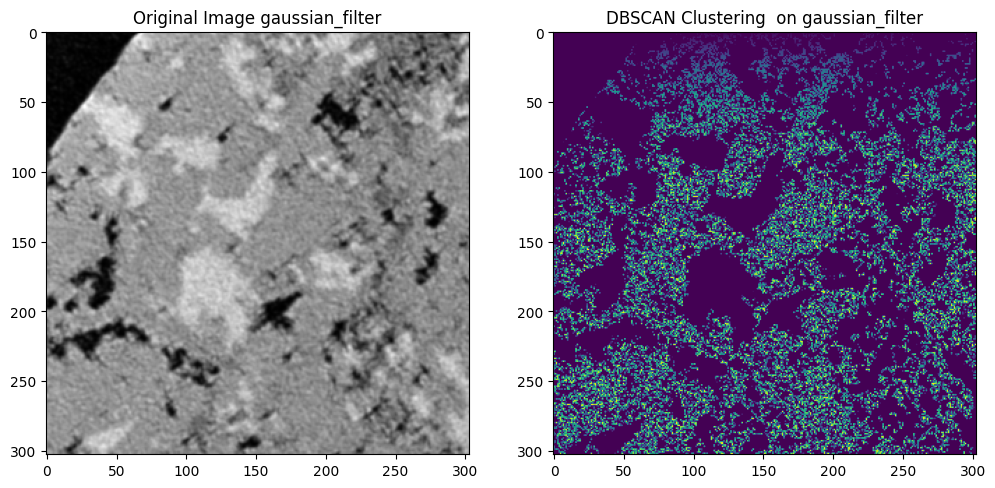

In [ ]:
matrix = imarray.copy()
sigma = 0.9
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


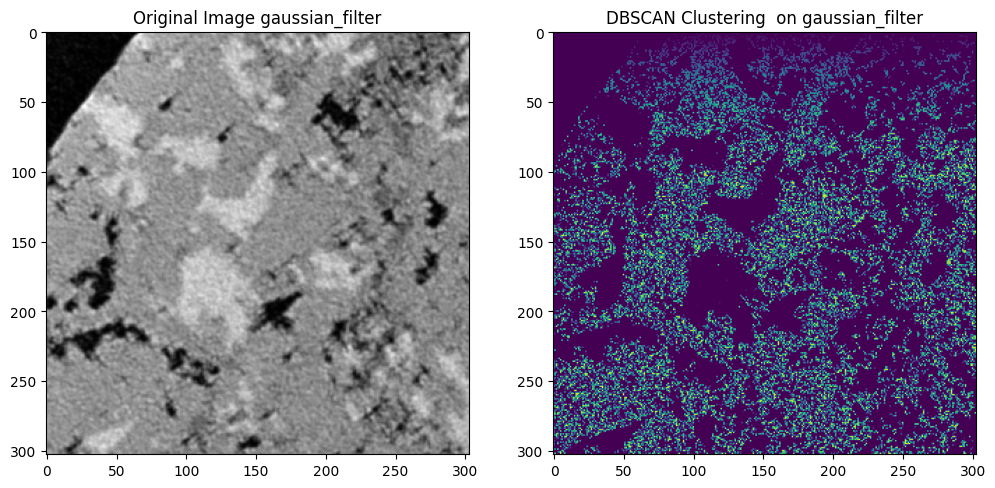

In [ ]:
matrix = imarray.copy()
sigma = 0.789
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


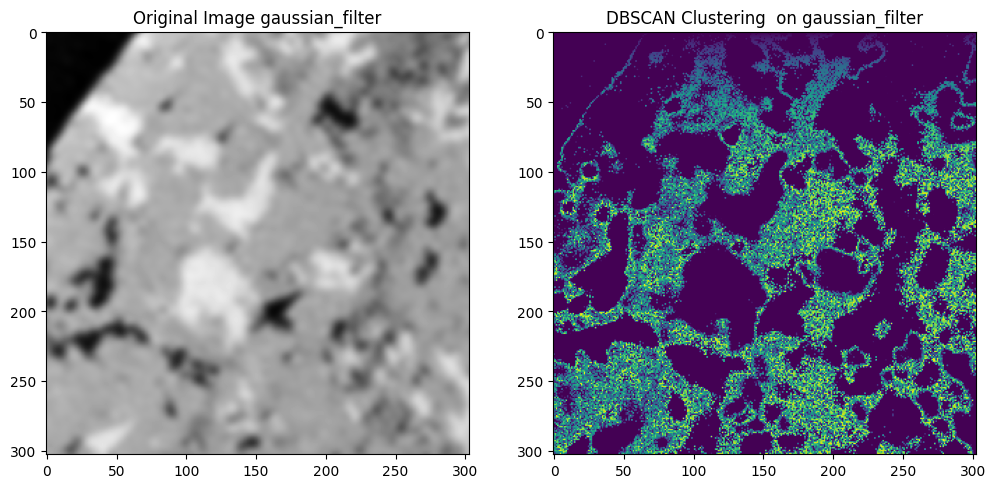

In [ ]:
matrix = imarray.copy()
sigma = 3
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


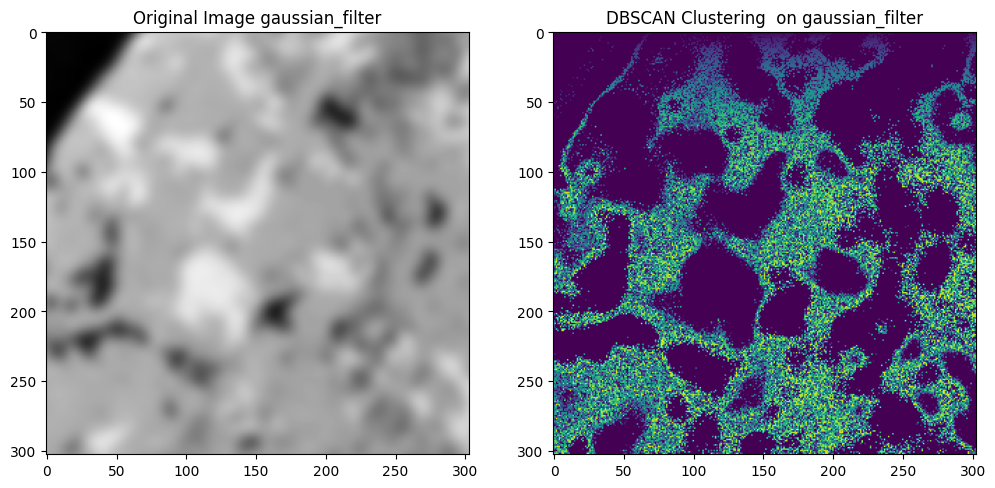

In [ ]:
matrix = imarray.copy()
sigma = 5
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


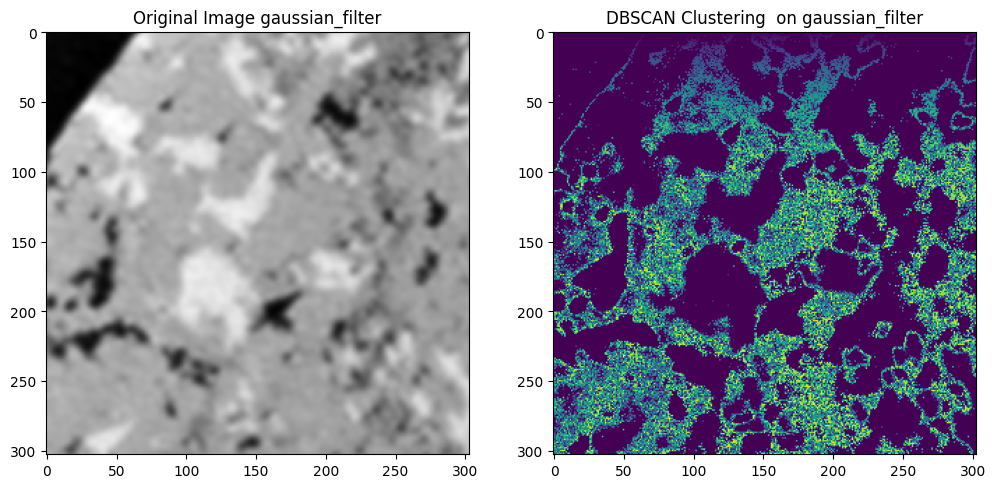

In [ ]:
matrix = imarray.copy()
sigma = 2.5
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(303, 303)


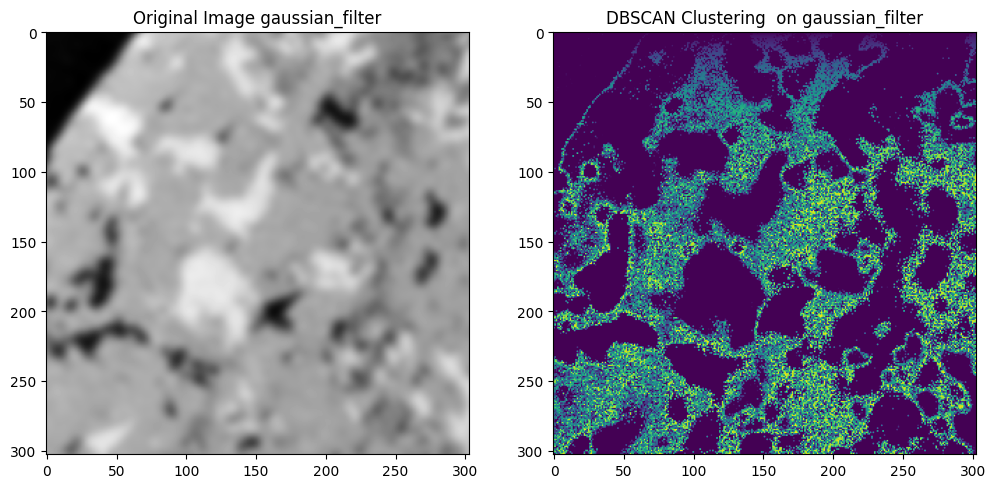

In [ ]:
matrix = imarray.copy()
sigma = 3.5
blurred_gaussian = gaussian_filter(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

### gaussian_gradient_magnitude

(303, 303)


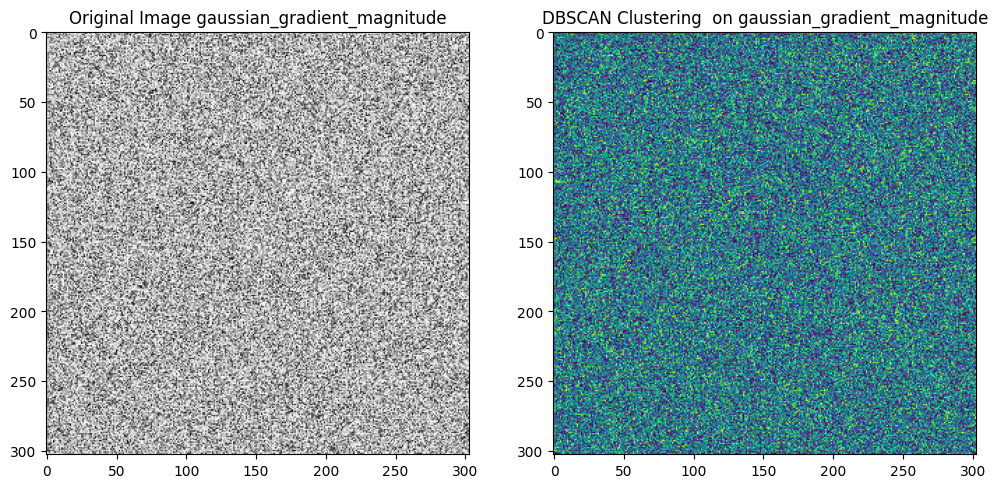

In [ ]:
matrix = imarray.copy()
sigma = 1
blurred_gaussian = gaussian_gradient_magnitude(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_gradient_magnitude')

### gaussian_laplace

(303, 303)


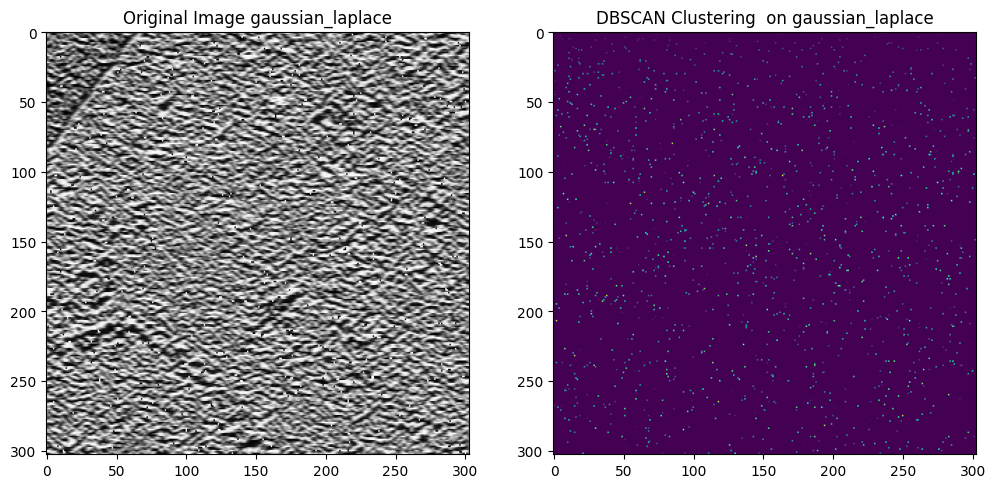

In [ ]:
matrix = imarray.copy()
sigma = 1.2

blurred_gaussian = gaussian_laplace(matrix, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_laplace')

### Laplace

(303, 303)


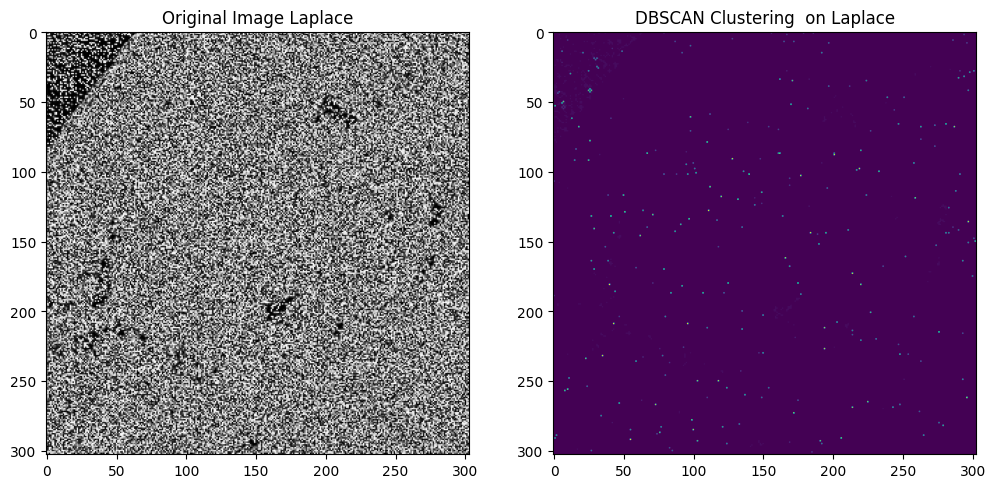

In [ ]:
matrix = imarray.copy()

lapls = laplace(matrix)

kern_part = lapls[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'Laplace')

### Sobel

In [ ]:
kern_part = sobell[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'Sobel')

### percentile_filtered

In [ ]:
percentile = 45
size = 3
percentile_filtered = percentile_filter(matrix, percentile, size=size)

kern_part = percentile_filtered[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'percentile_filtered')

In [ ]:
kern_part = percentile_filtered[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'percentile_filtered')

### Custom preprocessing

In [ ]:
matrix = imarray.copy()

percentile = 50
size = 3
percentile_filtered = percentile_filter(matrix, percentile, size=size)
test_db_scan(percentile_filtered[505:808, 300:603], 'custom-step-1')

sigma = 2
blurred_median = median_filter(percentile_filtered, size=sigma)
# kern_part = blurred_median[505:808, 300:603]

size = 3
kern_part = percentile_filter(blurred_median, percentile, size=size)
test_db_scan(kern_part[505:808, 300:603], 'custom-step-3')

sigma = 2
blurred_gaussian = gaussian_filter(kern_part, sigma=sigma)
kern_part = blurred_gaussian[505:808, 300:603]
# print(kern_part.shape)
test_db_scan(kern_part, 'custom-step-2')

In [ ]:
matrix = imarray.copy()
sigma = 14
blurred_median = median_filter(matrix, size=sigma)
test_db_scan(blurred_median[505:808, 300:603], 'custom-step-1')

size = 3
blurred_mean = fourier_ellipsoid(blurred_median, size=3)
kern_part = blurred_mean[505:808, 300:603]
# print(kern_part.shape)
test_db_scan(kern_part, 'custom-step-2')

### prewitt_result

In [ ]:
kern_part = prewitt_result[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'prewitt_result')

# Another Preprocess

## Wavelet

In [ ]:
from skimage import io, color

In [ ]:
image = imarray.copy()

image_with_noise = image[1222:1523, 1818:2119]
image_with_noise.shape

(301, 301)

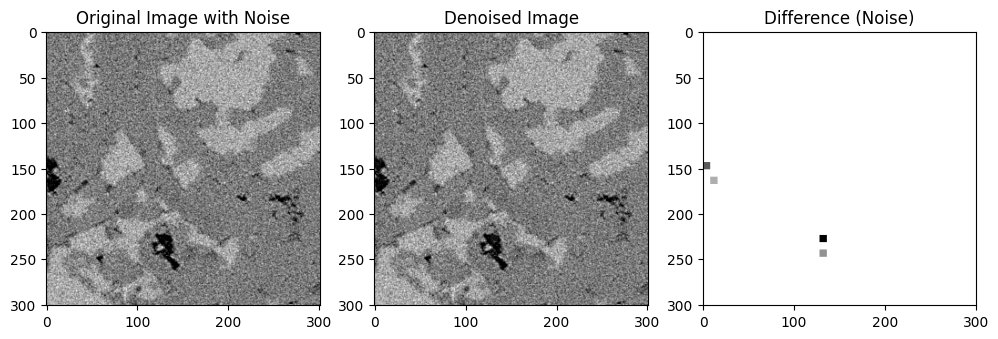

In [ ]:
coeffs = pywt.wavedec2(image_with_noise, 'db1', level=3)

threshold = np.sqrt(2 * np.log2(image_with_noise.size)) * np.std(image_with_noise)

coeffs_thresholded = [pywt.threshold(c, threshold, mode='soft') if isinstance(c, np.ndarray) else c for c in coeffs]

denoised_image = pywt.waverec2(coeffs_thresholded, 'db1')
denoised_image = denoised_image[:image_with_noise.shape[0], :image_with_noise.shape[1]]


plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.imshow(image_with_noise, cmap='gray')
plt.title('Original Image with Noise')

plt.subplot(1, 3, 2)
plt.imshow(denoised_image, cmap='gray')
plt.title('Denoised Image')

plt.subplot(1, 3, 3)
plt.imshow(image_with_noise - denoised_image, cmap='gray')
plt.title('Difference (Noise)')
plt.show()

In [ ]:
denoised_image.shape

(301, 301)

(301, 301)


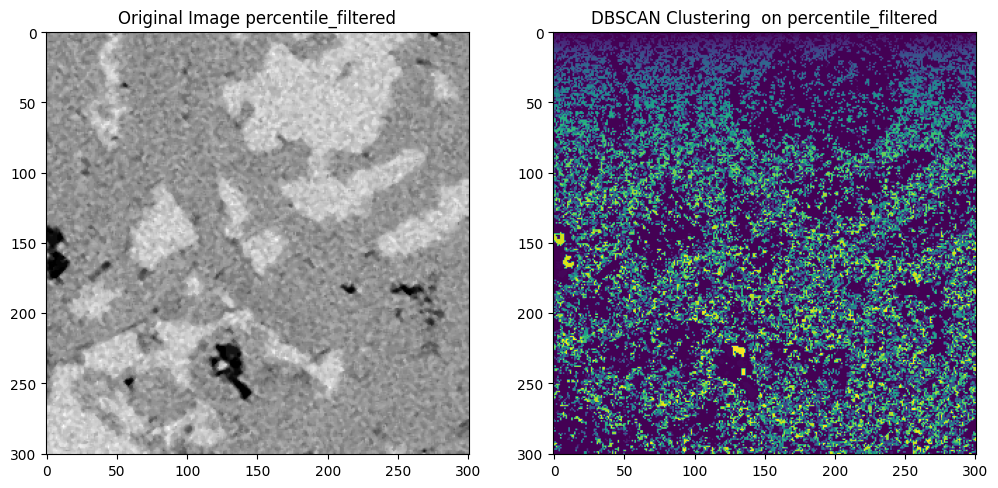

In [ ]:
percentile = 45
size = 3
percentile_filtered = percentile_filter(denoised_image, percentile, size=size)

kern_part = percentile_filtered
print(kern_part.shape)
test_db_scan(kern_part, 'percentile_filtered')

(301, 301)


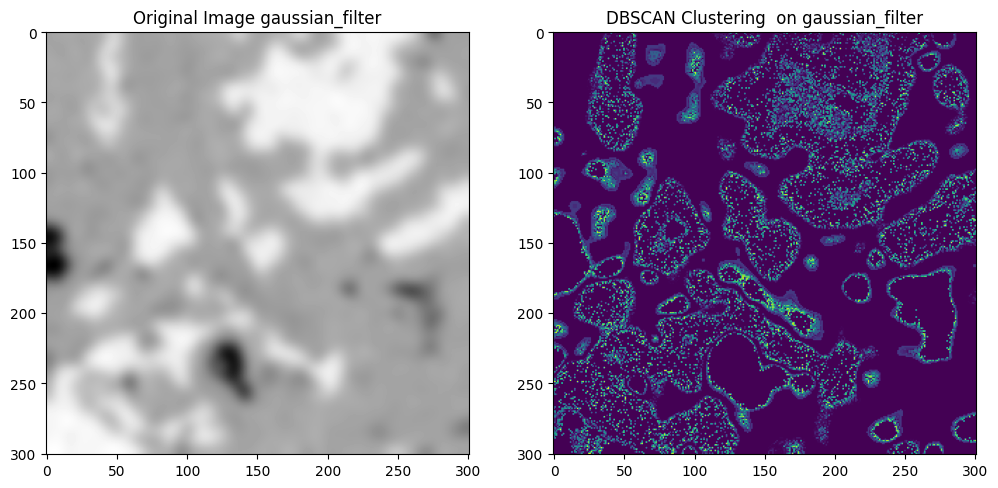

In [ ]:
sigma = 5
blurred_gaussian = gaussian_filter(denoised_image, sigma=sigma)

kern_part = blurred_gaussian
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

(301, 301)


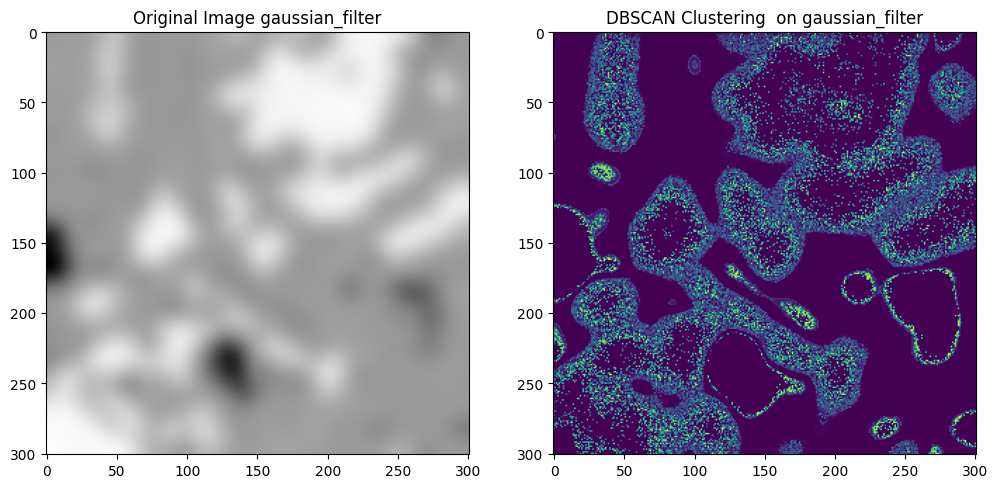

In [ ]:
sigma = 8
blurred_gaussian = gaussian_filter(denoised_image, sigma=sigma)

kern_part = blurred_gaussian
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

<Axes: >

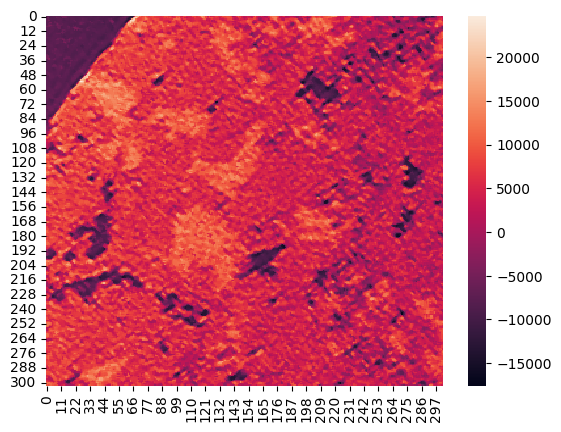

In [ ]:
sns.heatmap(kern_part)

## FFT

In [ ]:
image = imarray
image.shape

(2615, 2615)

In [ ]:
type(image)

numpy.ndarray

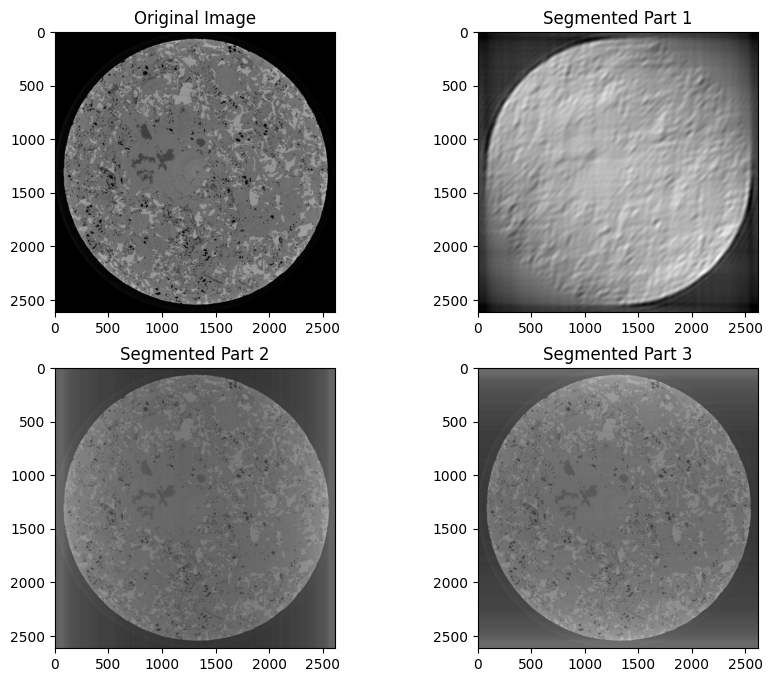

In [ ]:
fft_result = np.fft.fft2(image)

mask1 = np.zeros_like(fft_result)
mask1[:50, :50] = 1

mask2 = np.zeros_like(fft_result)
mask2[200:, :] = 1

mask3 = np.zeros_like(fft_result)
mask3[:, 200:] = 1

fft_result1 = fft_result * mask1
fft_result2 = fft_result * mask2
fft_result3 = fft_result * mask3

segmented_data1 = np.fft.ifft2(fft_result1).real
segmented_data2 = np.fft.ifft2(fft_result2).real
segmented_data3 = np.fft.ifft2(fft_result3).real

plt.figure(figsize=(10, 8))

plt.subplot(2, 2, 1)
plt.title('Original Image')
plt.imshow(image, cmap='gray')

plt.subplot(2, 2, 2)
plt.title('Segmented Part 1')
plt.imshow(segmented_data1, cmap='gray')

plt.subplot(2, 2, 3)
plt.title('Segmented Part 2')
plt.imshow(segmented_data2, cmap='gray')

plt.subplot(2, 2, 4)
plt.title('Segmented Part 3')
plt.imshow(segmented_data3, cmap='gray')

plt.show()

(301, 301)


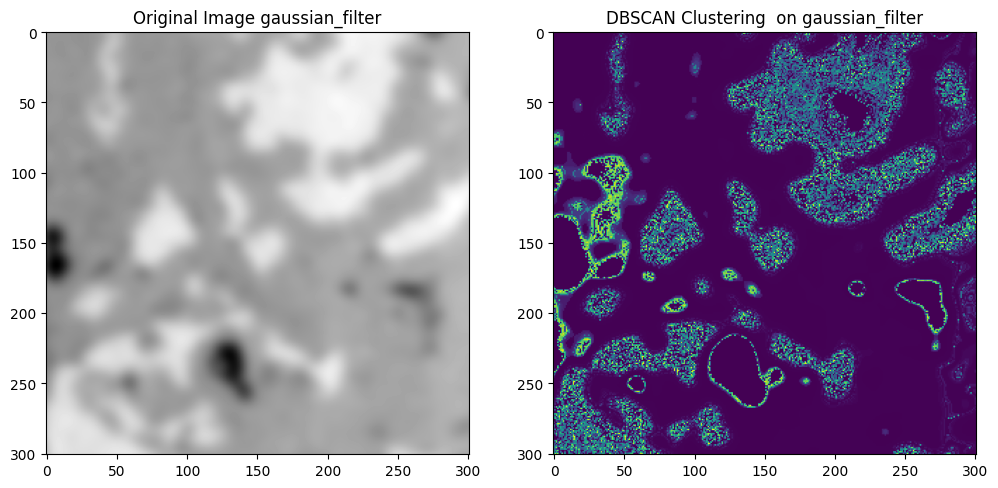

In [ ]:
sigma = 5
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

kern_part = blurred_gaussian[1222:1523, 1818:2119]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

In [ ]:
sns.histplot(kern_part.flatten())

(303, 303)


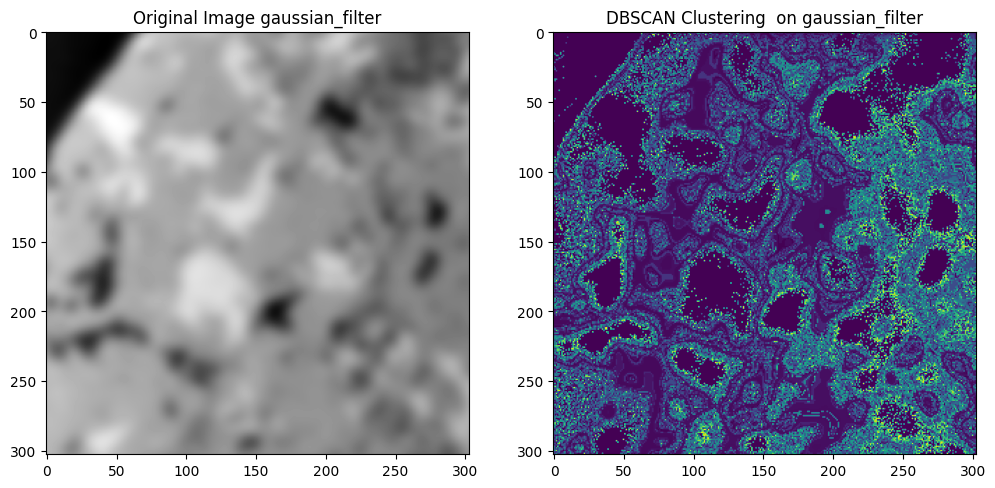

In [ ]:
sigma = 5
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

kern_part = blurred_gaussian[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'gaussian_filter')

<Axes: ylabel='Count'>

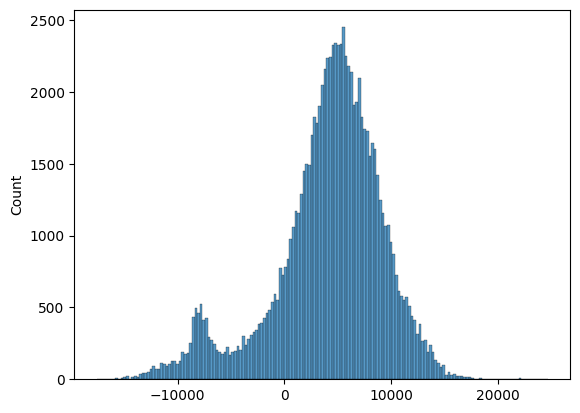

In [ ]:
sns.histplot(kern_part.flatten())

<Axes: ylabel='Count'>

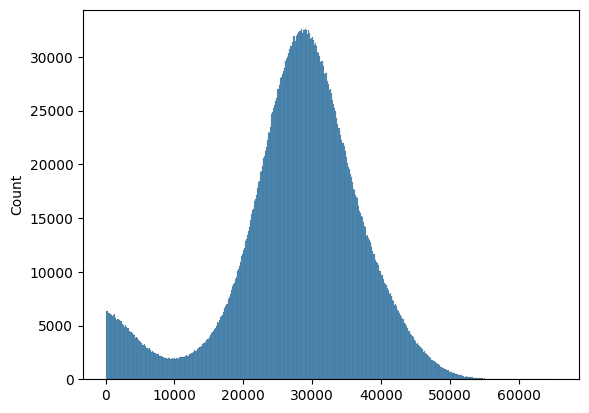

In [ ]:
lmp = imarray.flatten()
sns.histplot(lmp[lmp>1])

(303, 303)


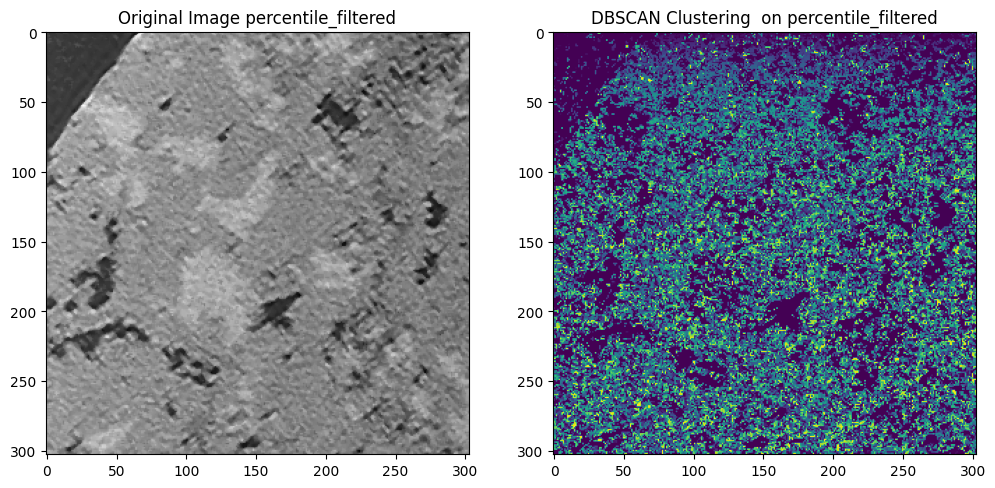

In [ ]:
percentile = 50
size = 3
percentile_filtered = percentile_filter(segmented_data2, percentile, size=size)

kern_part = percentile_filtered[505:808, 300:603]
print(kern_part.shape)
test_db_scan(kern_part, 'percentile_filtered')

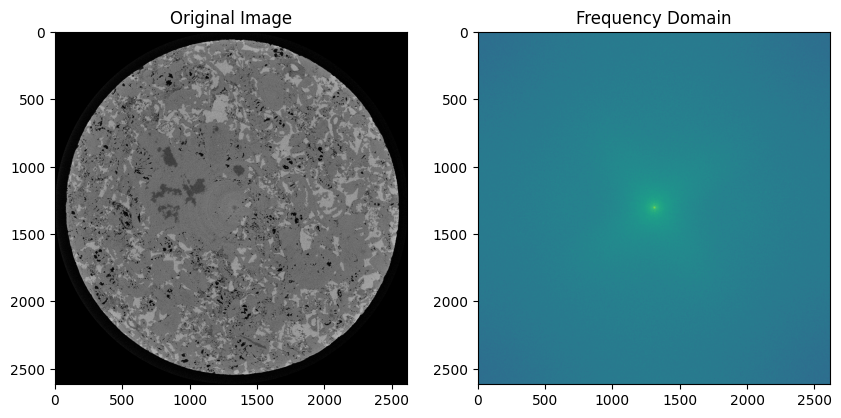

In [ ]:
fft_result = np.fft.fft2(image)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(image, cmap='gray')

plt.subplot(1, 2, 2)
plt.title('Frequency Domain')
plt.imshow(np.log(np.abs(np.fft.fftshift(fft_result)) + 1), cmap='viridis')

plt.show()

In [ ]:
def clustering(kern_part, eps, smpl, name='min_filtered', img_true=None):
  flattened_data = kern_part.flatten().reshape(-1, 1)

  dbscan = DBSCAN(eps=eps, min_samples=smpl)
  labels = dbscan.fit_predict(flattened_data)

  labels_2d = labels.reshape(kern_part.shape)

  draw_result(kern_part, labels_2d, name, img_true)

  return labels_2d

(303, 303)


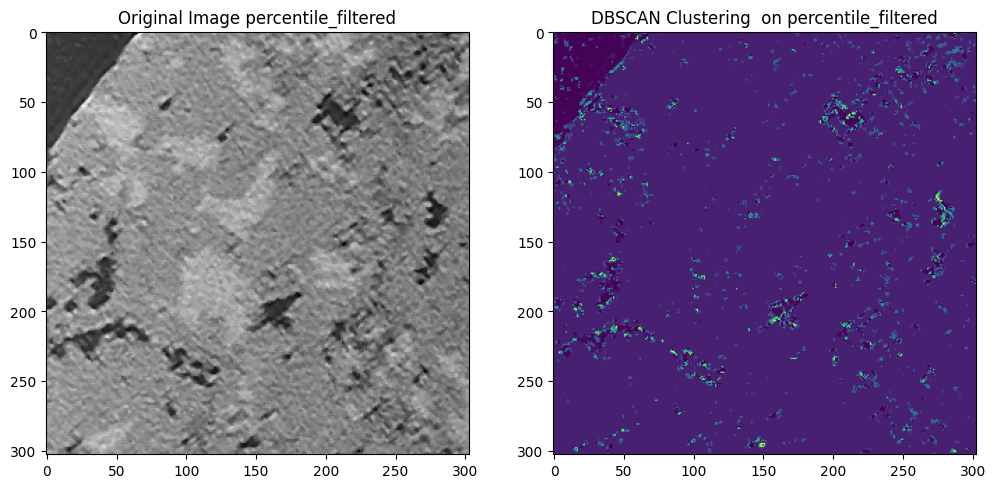

In [ ]:
percentile = 50
size = 3
percentile_filtered = percentile_filter(segmented_data2, percentile, size=size)

kern_part = percentile_filtered[505:808, 300:603]
print(kern_part.shape)
clustering(kern_part, 10, 10, 'percentile_filtered')

(303, 303)


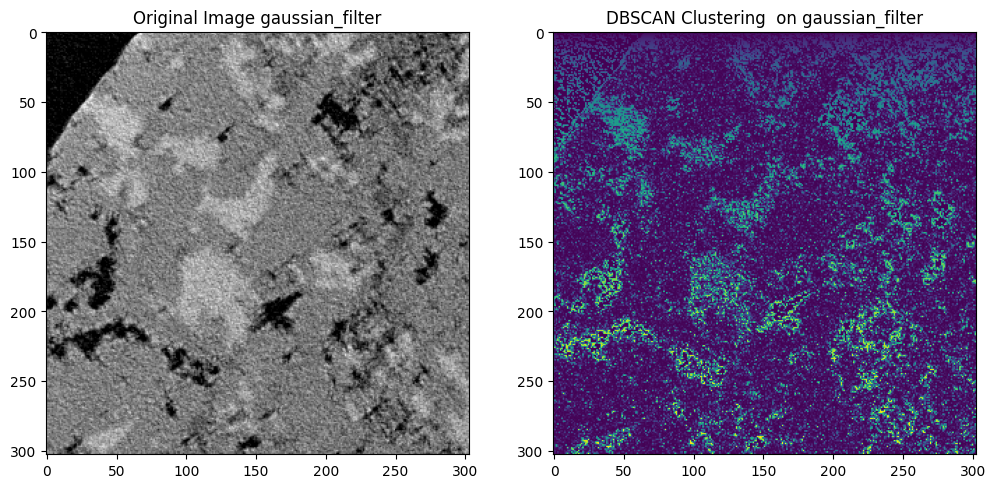

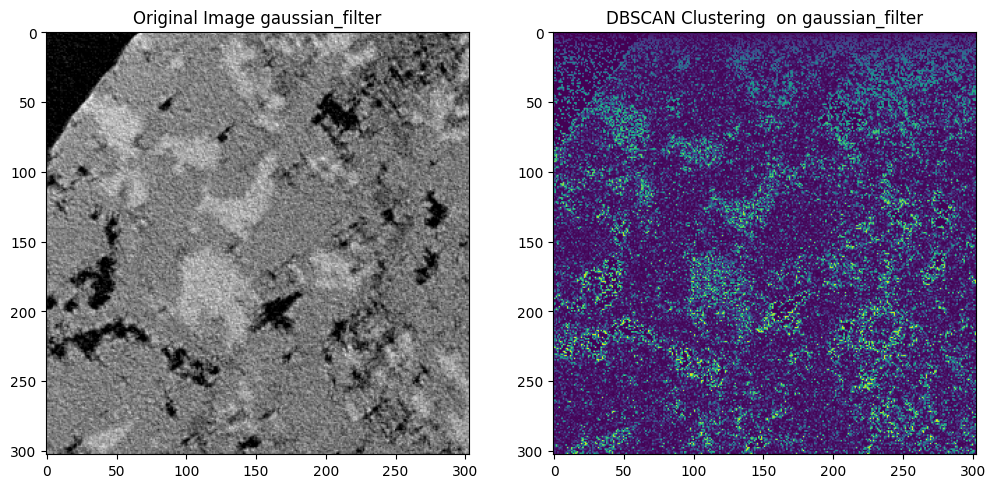

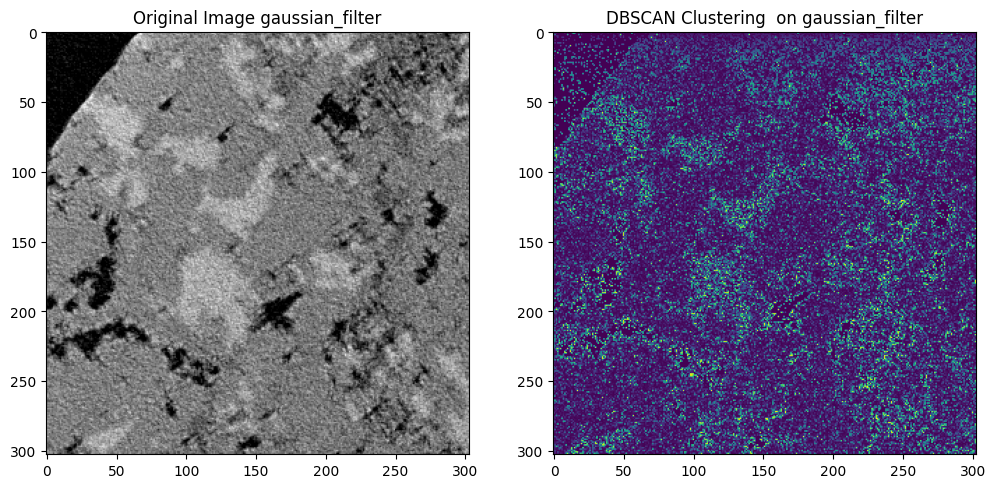

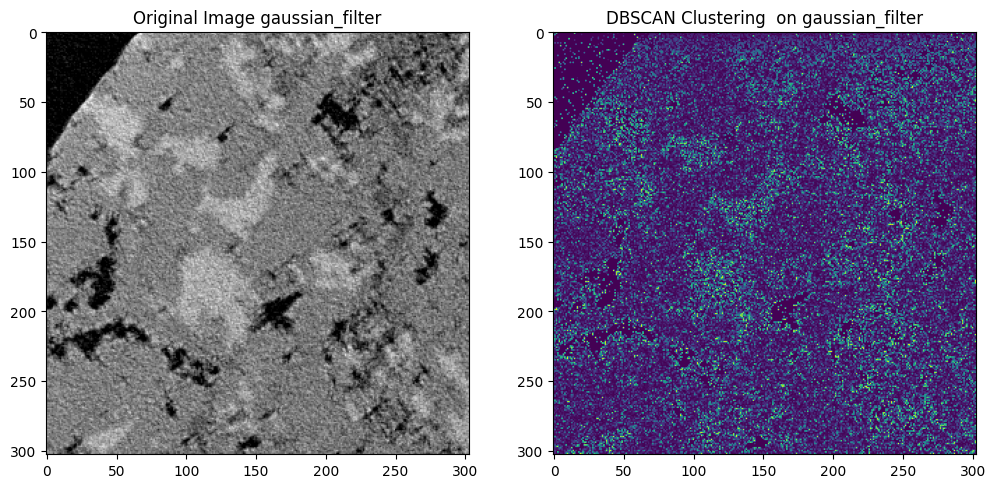

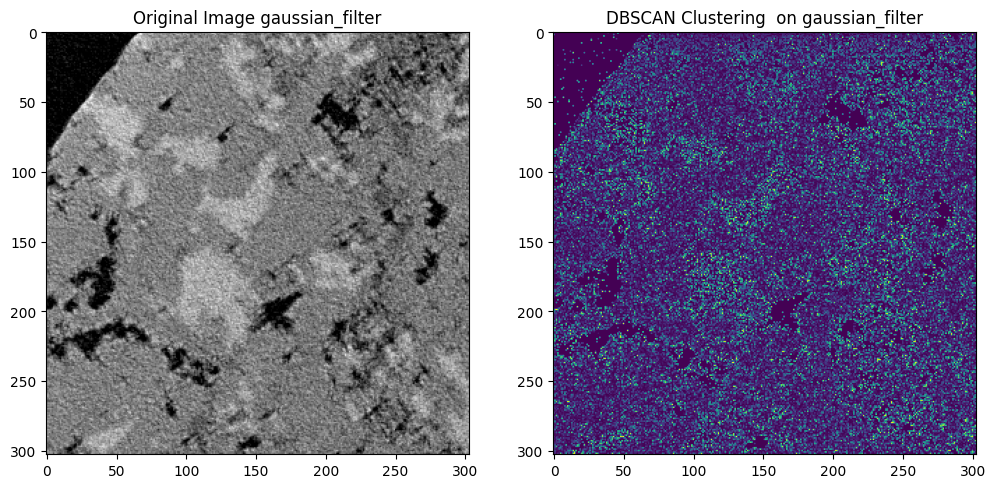

...

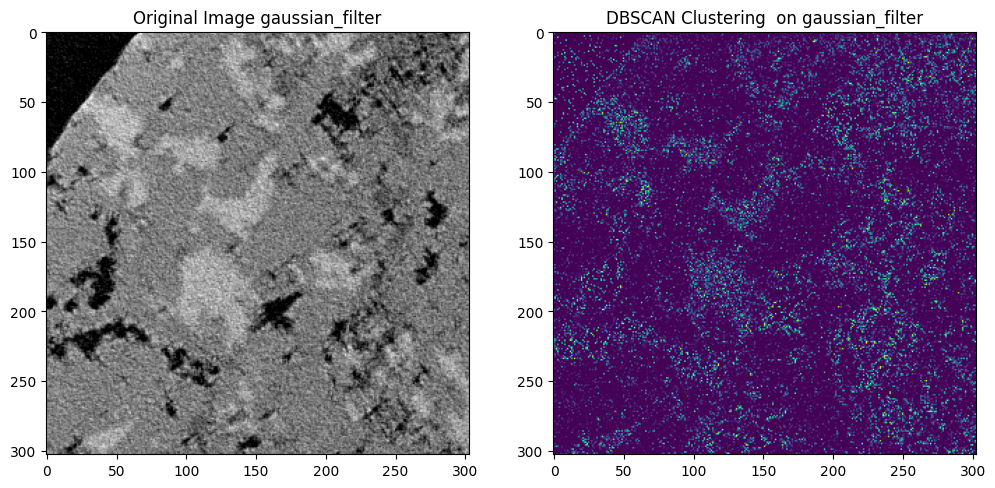

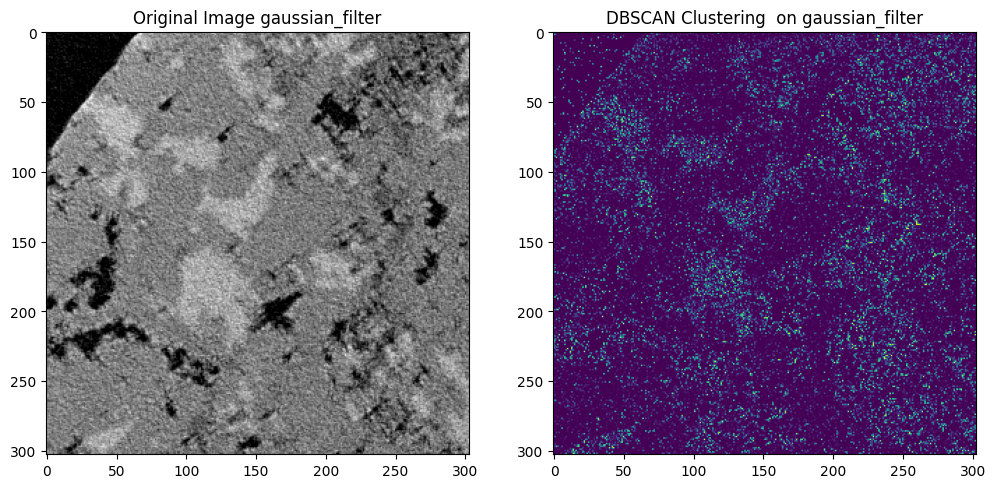

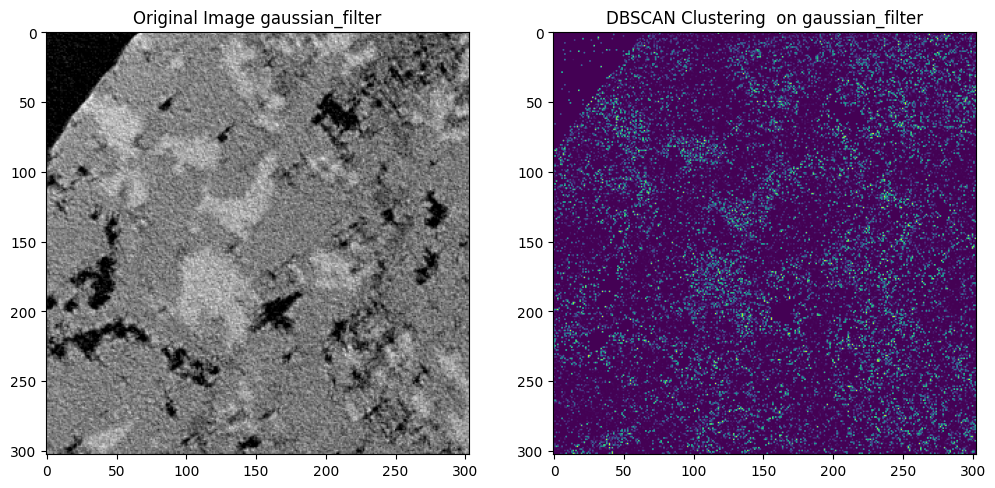

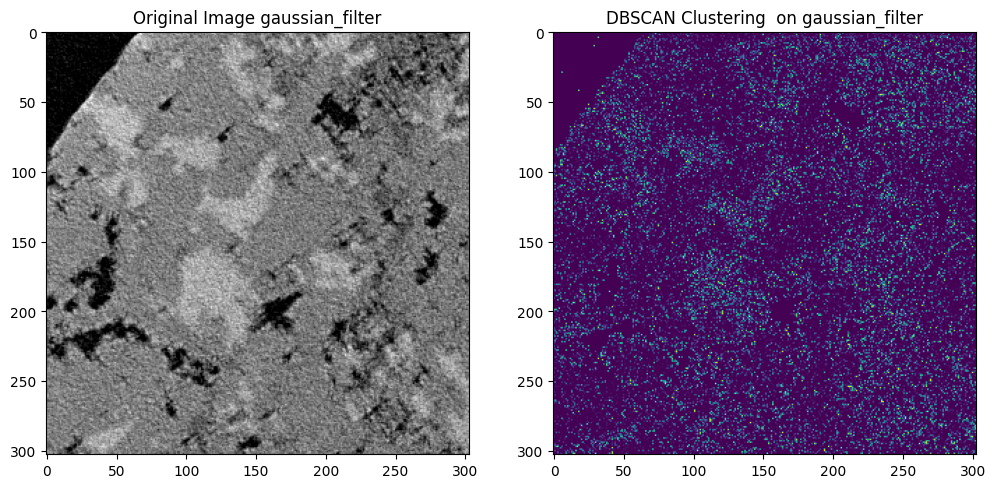

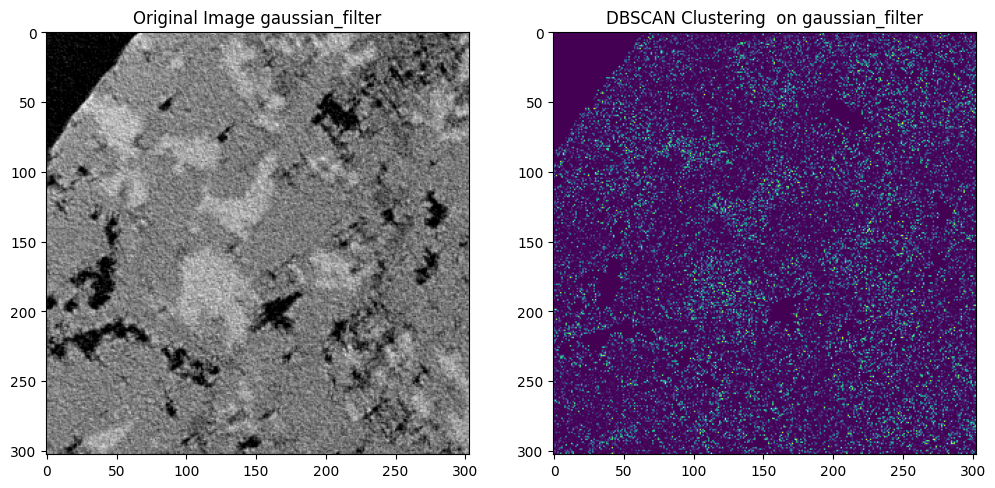

In [ ]:
sigma = 5
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

kern_part = imarray[505:808, 300:603]
print(kern_part.shape)
for eps in range(1, 3, 1):
  for n in range(1, 10, 1):
    clustering(kern_part, eps, n, 'gaussian_filter')

## Multi-Otsu

<ipython-input-22-9daa45e47772>:8: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  plt.imshow(image[505:808, 300:603], cmap='gray')
<ipython-input-22-9daa45e47772>:8: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(image[505:808, 300:603], cmap='gray')


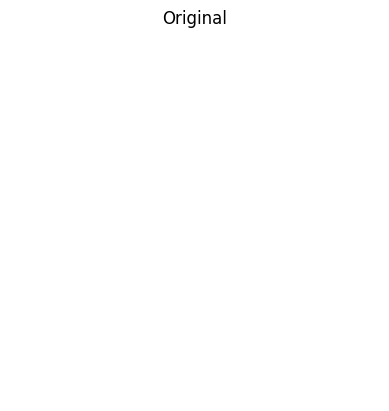

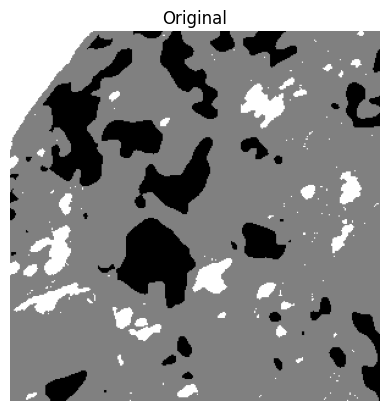

In [ ]:
image = imarray[800:1000, 800:1000]
thresholds = threshold_multiotsu(image)
regions = np.digitize(image, bins=thresholds)

plt.imshow(image[505:808, 300:603], cmap='gray')
plt.title('Original')
plt.axis('off')
plt.show()

plt.imshow(res[505:808, 300:603], cmap='gray')
plt.title('Original')
plt.axis('off')
plt.show()

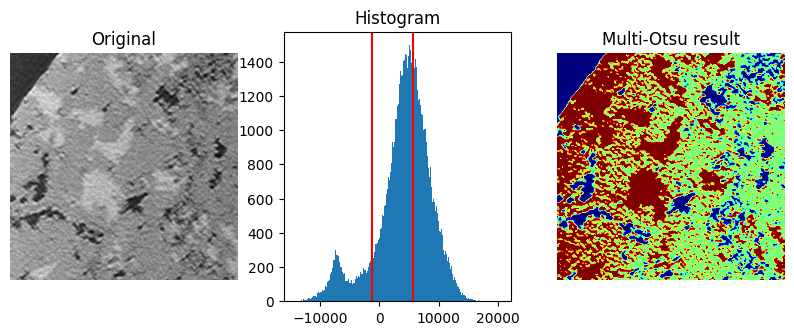

In [ ]:
sigma = 1
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

image = blurred_gaussian[505:808, 300:603]
thresholds = threshold_multiotsu(image)
regions = np.digitize(image, bins=thresholds)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 3.5))

ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original')
ax[0].axis('off')

ax[1].hist(image.ravel(), bins=255)
ax[1].set_title('Histogram')
for thresh in thresholds:
    ax[1].axvline(thresh, color='r')

ax[2].imshow(regions, cmap='jet')
ax[2].set_title('Multi-Otsu result')
ax[2].axis('off')

plt.subplots_adjust()

plt.show()

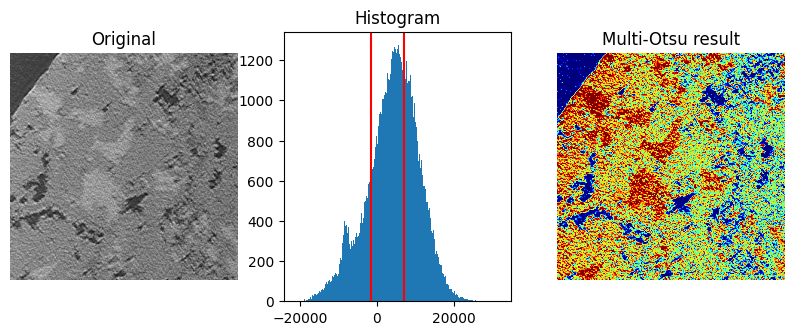

In [ ]:
sigma = 6

image = segmented_data2[505:808, 300:603]
thresholds = threshold_multiotsu(image, classes=3)
regions = np.digitize(image, bins=thresholds)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 3.5))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original')
ax[0].axis('off')

ax[1].hist(image.ravel(), bins=255)
ax[1].set_title('Histogram')
for thresh in thresholds:
    ax[1].axvline(thresh, color='r')

ax[2].imshow(regions, cmap='jet')
ax[2].set_title('Multi-Otsu result')
ax[2].axis('off')

plt.subplots_adjust()

plt.show()

<Axes: >

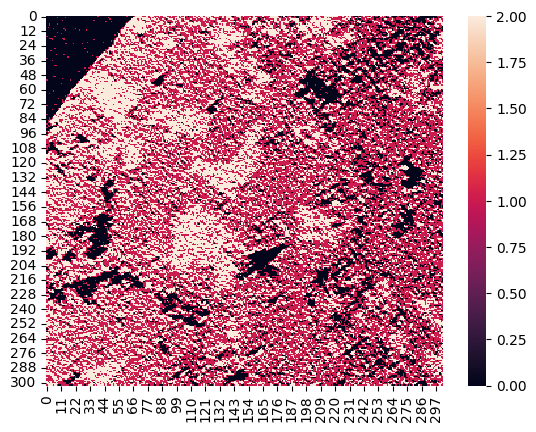

In [ ]:
sns.heatmap(regions)

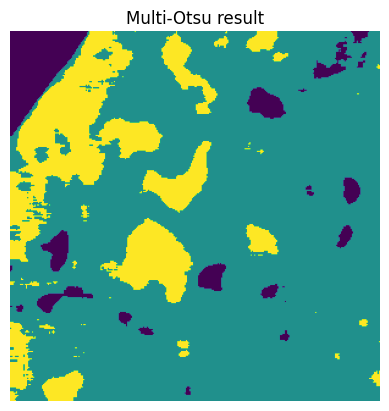

In [ ]:
rgr = median_filter(regions, size=13)
plt.imshow(rgr)
plt.title('Multi-Otsu result')
plt.axis('off')
plt.show()

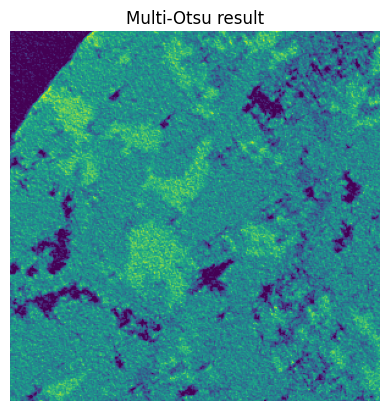

In [ ]:
plt.imshow(imarray[505:808, 300:603])
plt.title('Multi-Otsu result')
plt.axis('off')
plt.show()

# Estimate methods

In [ ]:
def calculate_ssim(img1, img2):
    img1 = img_as_ubyte(img1)
    img2 = img_as_ubyte(img2)

    similarity_index, _ = ssim(img1, img2, full=True)
    return similarity_index

def calculate_mse(img1, img2):
    img1 = img_as_ubyte(img1)
    img2 = img_as_ubyte(img2)

    mse_value = mse(img1, img2)
    return mse_value

def calculate_psnr(img1, img2):
    img1 = img_as_ubyte(img1)
    img2 = img_as_ubyte(img2)

    psnr_value = 10 * np.log10((255**2) / mse(img1, img2))
    return psnr_value

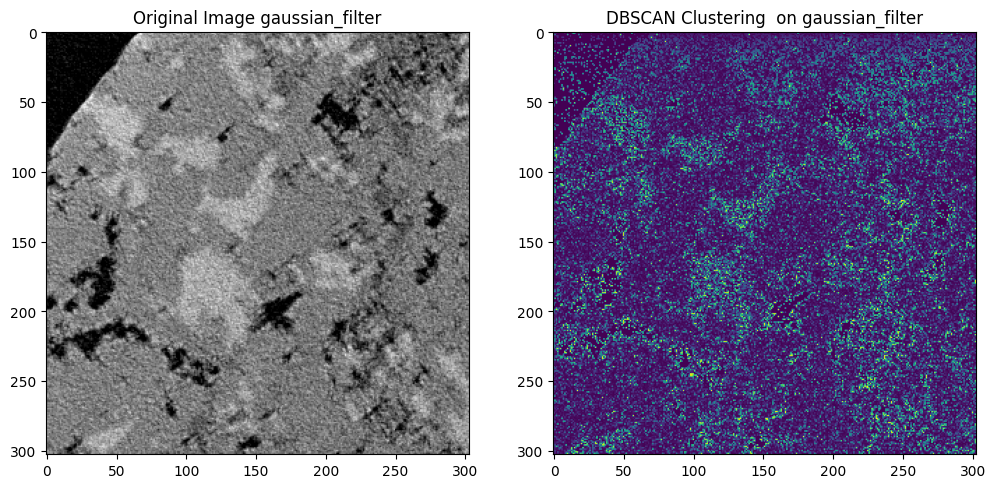

SSIM: 0.4393
MSE: 8.7720
PSNR: 38.70 dB


In [ ]:
gpm = clustering(kern_part, 1, 3, 'gaussian_filter')

img1 = res[505:808, 300:603]
img2 = gpm

ssim_value = calculate_ssim(img1, img2)
mse_value = calculate_mse(img1, img2)
psnr_value = calculate_psnr(img1, img2)

print(f"SSIM: {ssim_value:.4f}")
print(f"MSE: {mse_value:.4f}")
print(f"PSNR: {psnr_value:.2f} dB")

In [ ]:
img1 = res[505:808, 300:603]
img2 = res[505:808, 300:603] + 0.1 * np.random.randn(303, 303)
img2 = img2 / np.max(img2)

ssim_value = calculate_ssim(img1, img2)
mse_value = calculate_mse(img1, img2)
psnr_value = calculate_psnr(img1, img2)

print(f"SSIM: {ssim_value:.4f}")
print(f"MSE: {mse_value:.4f}")
print(f"PSNR: {psnr_value:.2f} dB")

SSIM: 0.0165
MSE: 28129.2790
PSNR: 3.64 dB


<Axes: >

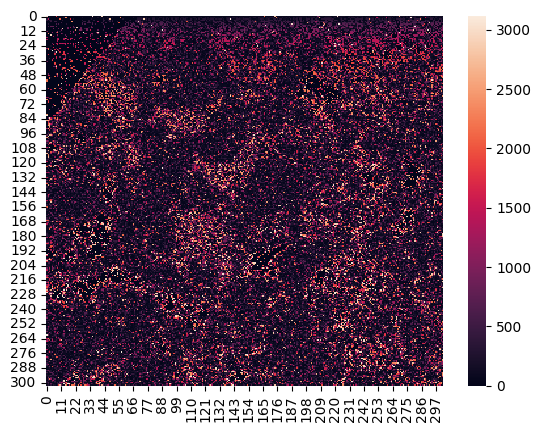

In [ ]:
sns.heatmap(gpm)

In [ ]:
img1 = imarray[505:808, 300:603]
img2 = res[505:808, 300:603]

# Calculate metrics
ssim_value = calculate_ssim(img1, img2)
mse_value = calculate_mse(img1, img2)
psnr_value = calculate_psnr(img1, img2)

# Print the results
print(f"SSIM: {ssim_value:.4f}")
print(f"MSE: {mse_value:.4f}")
print(f"PSNR: {psnr_value:.2f} dB")

SSIM: 0.0174
MSE: 12079.4326
PSNR: 7.31 dB


## Check correlation

In [ ]:
def check_correlation(matrix1, matrix2, alpha=0.05):
    flattened_matrix1 = matrix1.flatten()
    flattened_matrix2 = matrix2.flatten()

    correlation_coefficient, p_value = pearsonr(flattened_matrix1, flattened_matrix2)
    correlation_exists = p_value < alpha
    if correlation_exists:
        conclusion = f"There is a significant correlation (p-value: {p_value:.4f})"
    else:
        conclusion = f"No significant correlation (p-value: {p_value:.4f})"

    return correlation_exists, correlation_coefficient, p_value, conclusion

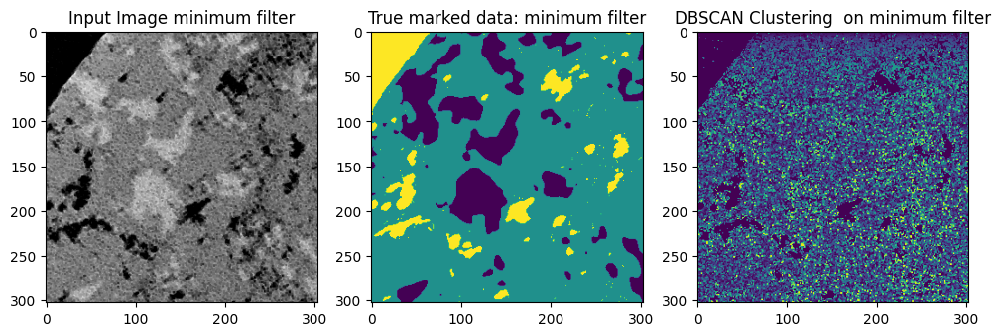

Correlation Exists: True
Correlation Coefficient: -0.12583459857476548
P-Value: 1.339e-320
There is a significant correlation (p-value: 0.0000)


In [ ]:
# correlation
size = 2
min_filtered = minimum_filter(imarray.copy(), size=size)

img1 = res[505:808, 300:603]
img2 = gpm = clustering(min_filtered[505:808, 300:603], 1, 5, 'minimum filter', img1)

correlation_exists, correlation_coefficient, p_value, conclusion = check_correlation(img1, img2)

print(f"Correlation Exists: {correlation_exists}")
print(f"Correlation Coefficient: {correlation_coefficient}")
print(f"P-Value: {p_value}")
print(conclusion)

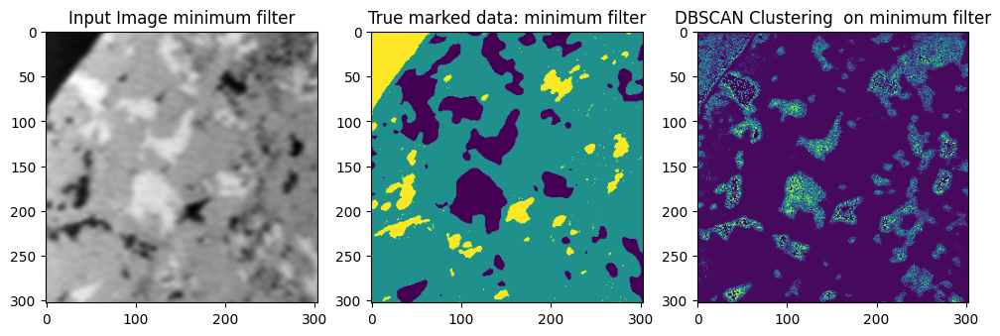

Correlation Exists: False
Correlation Coefficient: 0.004899625167852235
P-Value: 0.13765640952405947
No significant correlation (p-value: 0.1377)


In [ ]:
# correlation
sigma = 3
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

img1 = res[505:808, 300:603]
img2 = gpm = clustering(blurred_gaussian[505:808, 300:603], 1, 3, 'minimum filter', img1)

correlation_exists, correlation_coefficient, p_value, conclusion = check_correlation(img1, img2)

print(f"Correlation Exists: {correlation_exists}")
print(f"Correlation Coefficient: {correlation_coefficient}")
print(f"P-Value: {p_value}")
print(conclusion)

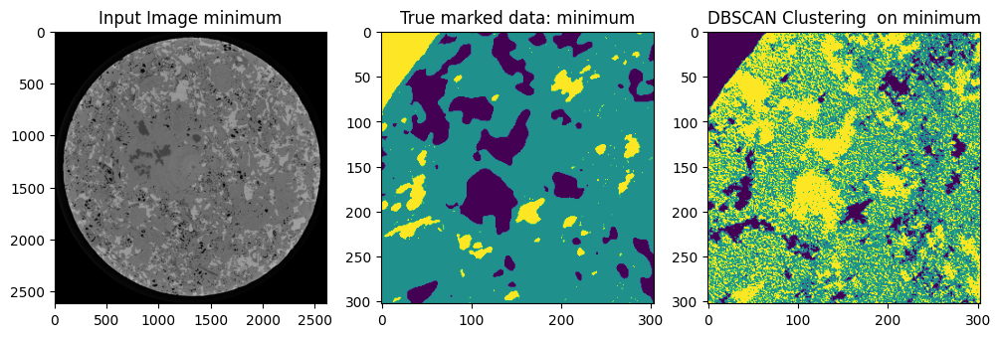

Correlation Exists: True
Correlation Coefficient: -0.5644204803880061
P-Value: 0.0
There is a significant correlation (p-value: 0.0000)


In [ ]:
# correlation
sigma = 3
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

img1 = res[505:808, 300:603]
thresholds = threshold_multiotsu(imarray[505:808, 300:603], classes=3)
img2 = np.digitize(imarray[505:808, 300:603], bins=thresholds)

draw_result(imarray, img2, name_method='minimum', true_plot=img1)

correlation_exists, correlation_coefficient, p_value, conclusion = check_correlation(img1, img2)

print(f"Correlation Exists: {correlation_exists}")
print(f"Correlation Coefficient: {correlation_coefficient}")
print(f"P-Value: {p_value}")
print(conclusion)

In [ ]:
# correlation
sigma = 5
blurred_gaussian = gaussian_filter(segmented_data2, sigma=sigma)

img1 = res[505:808, 300:603]

correlation_exists, correlation_coefficient, p_value, conclusion = check_correlation(img1, img1)

print(f"Correlation Exists: {correlation_exists}")
print(f"Correlation Coefficient: {correlation_coefficient}")
print(f"P-Value: {p_value}")
print(conclusion)

Correlation Exists: True
Correlation Coefficient: 1.0
P-Value: 0.0
There is a significant correlation (p-value: 0.0000)


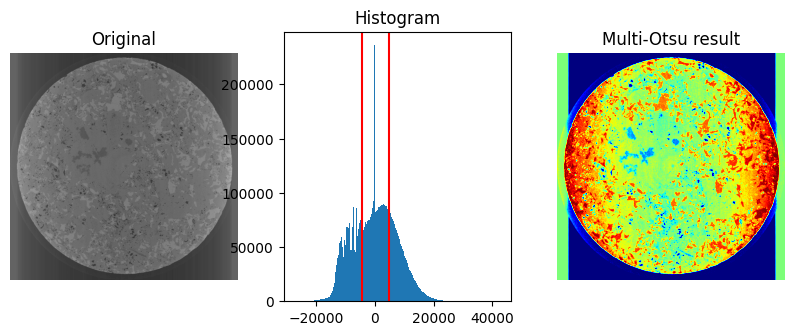

Correlation Exists: True
Correlation Coefficient: -0.5773355291032214
P-Value: 0.0
There is a significant correlation (p-value: 0.0000)


In [ ]:
# correlation
img1 = res
image = segmented_data2[505:808, 300:603]
thresholds = threshold_multiotsu(image, classes=3)
regions = np.digitize(image, bins=thresholds)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 3.5))

correlation_exists, correlation_coefficient, p_value, conclusion = check_correlation(img1, regions)

print(f"Correlation Exists: {correlation_exists}")
print(f"Correlation Coefficient: {correlation_coefficient}")
print(f"P-Value: {p_value}")
print(conclusion)

### Threshold segmentation

In [ ]:
def plot_2d_array_with_threshold(input_array, threshold):
    thresholded_array = np.where(input_array > threshold, input_array, 0)

    plt.imshow(np.rint(thresholded_array), cmap='viridis')
    plt.colorbar()
    plt.show()

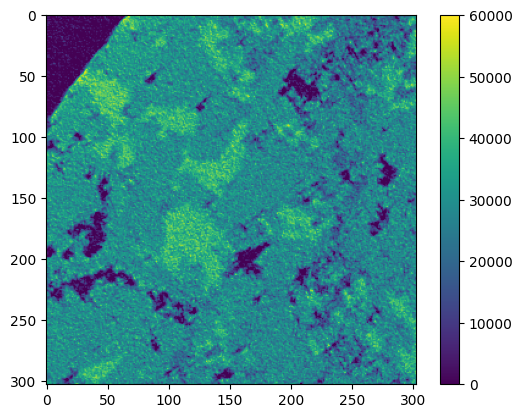

In [ ]:
threshold_value = 0.5

plot_2d_array_with_threshold(imarray[505:808, 300:603], threshold_value)